<h2>Геокодирование было сделано с использованием дага Airflow в файле kaliningrad_buildings.py</h2>

In [6]:
!pip install folium matplotlib mapclassify

     ---------------------------------------- 0.0/100.3 kB ? eta -:--:--
     --------------- --------------------- 41.0/100.3 kB 653.6 kB/s eta 0:00:01
     -------------------------------------- 100.3/100.3 kB 1.2 MB/s eta 0:00:00
  Using cached mapclassify-2.6.0-py3-none-any.whl (40 kB)



[notice] A new release of pip is available: 23.0.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [1]:
import geopandas as gpd
import osmnx as ox

c:\users\alexk\appdata\local\programs\python\python38\lib\site-packages\geopandas\_compat.py:123: UserWarning: The Shapely GEOS version (3.10.3-CAPI-1.16.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(


<h1>Читаем данные о зданиях в Калининграде<h1>

In [2]:
buildings = gpd.read_file("building.geojson")

In [3]:
buildings

,addr_house,addr_postc,addr_stree,building_l,building_1,year_of_co,name,start_date,is_living,id,...,osm_type,osm_id,lat,lon,display_name,class,type,importance,area,geometry
0,1,236006.0,улица Канта,cathedral,8,NaN,Кафедральный собор,1333-09-13,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2558.467926,"MULTIPOLYGON (((20.51145 54.70662, 20.51160 54..."
1,4,NaN,проспект Мира,civic,4,NaN,Калининградский областной драматический театр,NaN,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2906.330011,"MULTIPOLYGON (((20.49184 54.71944, 20.49182 54..."
2,19/21,NaN,проспект Мира,hotel,5,NaN,"Здание страховго общества ""Северная звезда""",1936,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2625.769565,"MULTIPOLYGON (((20.48696 54.71911, 20.48691 54..."
3,NaN,NaN,NaN,retail,4,NaN,Виктория,NaN,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3928.826205,"MULTIPOLYGON (((20.50150 54.69503, 20.50236 54..."
4,137,NaN,проспект Победы,yes,NaN,NaN,Виктория,NaN,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5125.072749,"MULTIPOLYGON (((20.44184 54.70982, 20.44209 54..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23908,NaN,NaN,NaN,university,4,NaN,NaN,NaN,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4370.401174,"MULTIPOLYGON (((20.50578 54.72032, 20.50572 54..."
23909,10,NaN,Юбилейная улица,apartments,9,NaN,NaN,NaN,1,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2308.606474,"MULTIPOLYGON (((20.53922 54.71849, 20.53971 54..."
23910,NaN,NaN,NaN,yes,NaN,NaN,NaN,NaN,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,305.605432,"MULTIPOLYGON (((20.36453 54.72849, 20.36459 54..."
23911,NaN,NaN,NaN,apartments,7,NaN,NaN,NaN,1,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2920.359252,"MULTIPOLYGON (((20.51670 54.70085, 20.51687 54..."


<h1>Смотрим, какие колонки есть у зданий,чтобы выбрать нужные</h1>

In [4]:
buildings.iloc[0].to_list()

['1',
 236006.0,
 'улица Канта',
 'cathedral',
 '8',
 nan,
 'Кафедральный собор',
 '1333-09-13',
 0,
 nan,
 nan,
 nan,
 nan,
 nan,
 'обл',
 'Калининградская',
 nan,
 nan,
 'г',
 'Калининград',
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 0.0,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 2558.4679257550474,

In [5]:
buildings.columns.to_list()

['addr_house',
 'addr_postc',
 'addr_stree',
 'building_l',
 'building_1',
 'year_of_co',
 'name',
 'start_date',
 'is_living',
 'id',
 'region_id',
 'area_id',
 'city_id',
 'street_id',
 'shortname_',
 'formalname',
 'shortnam_1',
 'formalna_1',
 'shortnam_2',
 'formalna_2',
 'shortnam_3',
 'formalna_3',
 'house_numb',
 'building_r',
 'block',
 'letter',
 'address_left',
 'houseguid_left',
 'management',
 'built_year',
 'exploitati',
 'project_ty',
 'house_type',
 'is_alarm',
 'method_of_',
 'floor_coun',
 'floor_co_1',
 'entrance_c',
 'elevators_',
 'energy_eff',
 'quarters_c',
 'living_qua',
 'unliving_q',
 'area_total',
 'area_resid',
 'area_non_r',
 'area_commo',
 'area_land',
 'parking_sq',
 'playground',
 'sportsgrou',
 'other_beau',
 'foundation',
 'floor_type',
 'wall_mater',
 'basement_a',
 'chute_type',
 'chute_coun',
 'electrical',
 'electric_1',
 'heating_ty',
 'hot_water_',
 'cold_water',
 'sewerage_t',
 'sewerage_c',
 'gas_type',
 'ventilatio',
 'firefighti',
 'drainage_

In [6]:
important_columns = ['built_year', 'entrance_c', 'is_living', 'heating_ty', 'total_ppl', 'area', 'area_total', 'geometry']

<h1>Заполняем пропуски в типе обогрева зданий</h1>

In [7]:
buildings["heating_ty"] = buildings["heating_ty"].fillna("Отсутствует")

In [8]:
buildings["heating_ty"].isna().sum()

0

<h1>Используем Label Encoder, чтобы конвертировать типы отопления в числа</h1>

In [9]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
buildings["heating_ty"] = le.fit_transform(buildings["heating_ty"].values)

In [10]:
buildings["heating_ty"].unique()

array([4, 6, 3, 0, 2, 5, 1])

In [11]:
new_buildings = buildings[important_columns]

<h1>Проверяем типы колонок, чтобы все были числовыми</h1>

In [12]:
new_buildings.dtypes

built_year     float64
entrance_c     float64
is_living        int64
heating_ty       int32
total_ppl      float64
area           float64
area_total      object
geometry      geometry
dtype: object

<h1>Конвертируем колонку area_total в float, перед этим заменив запятые на десятичные точки</h1>

In [13]:
new_buildings["area_total"] = new_buildings["area_total"].str.replace(',','.')
new_buildings["area_total"].unique()

c:\users\alexk\appdata\local\programs\python\python38\lib\site-packages\geopandas\geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


array([nan, '5880.20', '3469.60', ..., '4451.00', '15950.00', '13779.50'],
      dtype=object)

In [14]:
new_buildings = new_buildings.astype({"area_total": float})

In [15]:
new_buildings.dtypes

built_year     float64
entrance_c     float64
is_living        int64
heating_ty       int32
total_ppl      float64
area           float64
area_total     float64
geometry      geometry
dtype: object

<h1>Сохраняем получившийся геодатафрейм</h1>

In [16]:
new_buildings.to_file("new_buildings.geojson", driver="GeoJSON")

In [88]:
!pip install xgboost

     ---------------------------------------- 0.0/99.7 MB ? eta -:--:--
     --------------------------------------- 0.0/99.7 MB 960.0 kB/s eta 0:01:44
     ---------------------------------------- 0.2/99.7 MB 1.5 MB/s eta 0:01:07
     ---------------------------------------- 0.4/99.7 MB 2.3 MB/s eta 0:00:44
     ---------------------------------------- 0.7/99.7 MB 3.4 MB/s eta 0:00:30
      --------------------------------------- 1.5/99.7 MB 5.5 MB/s eta 0:00:18
     - -------------------------------------- 2.6/99.7 MB 7.9 MB/s eta 0:00:13
     - -------------------------------------- 3.9/99.7 MB 10.3 MB/s eta 0:00:10
     -- ------------------------------------- 5.2/99.7 MB 11.9 MB/s eta 0:00:08
     -- ------------------------------------- 6.1/99.7 MB 12.6 MB/s eta 0:00:08
     -- ------------------------------------- 7.4/99.7 MB 13.9 MB/s eta 0:00:07
     --- ------------------------------------ 9.1/99.7 MB 15.3 MB/s eta 0:00:06
     ---- ---------------------------------- 10.4/99.


[notice] A new release of pip is available: 23.0.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


<h1>Запускаем заполнение данных</h1>

In [17]:
from CityGeoTools.data_imputer.imputer import DataImputer
dataset_path = "./new_buildings.geojson"
imputer = DataImputer(dataset_path)
imputer.add_neighbors_features()
full_data = imputer.multiple_imputation(save_models=False, save_logs=False)

Iteration of Imputation 1: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [13:44<00:00, 91.62s/it]


In [18]:
full_data

,built_year,entrance_c,is_living,heating_ty,total_ppl,area,area_total,built_year_is_imputed,entrance_c_is_imputed,is_living_is_imputed,heating_ty_is_imputed,total_ppl_is_imputed,area_is_imputed,area_total_is_imputed,geometry
0,2001,3,0,4,0,2558.467926,1941.652106,True,True,False,False,False,False,True,"MULTIPOLYGON (((-302533.446 6134008.531, -3025..."
1,1967,3,0,4,0,2906.330011,1551.745555,True,True,False,False,False,False,True,"MULTIPOLYGON (((-303530.885 6135650.022, -3035..."
2,1959,3,0,4,0,2625.769565,1551.745555,True,True,False,False,False,False,True,"MULTIPOLYGON (((-303848.971 6135669.662, -3038..."
3,1979,4,0,4,0,3928.826205,1551.745555,True,True,False,False,False,False,True,"MULTIPOLYGON (((-303400.985 6132844.276, -3033..."
4,1962,3,0,4,0,5125.072749,1969.004678,True,True,False,False,False,False,True,"MULTIPOLYGON (((-306917.567 6135168.176, -3068..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23908,1982,3,0,4,0,4370.401174,1874.406654,True,True,False,False,False,False,True,"MULTIPOLYGON (((-302622.828 6135585.450, -3026..."
23909,1971,3,1,4,44,2308.606474,2348.957827,True,True,False,False,False,False,True,"MULTIPOLYGON (((-300522.739 6134997.754, -3004..."
23910,1965,2,0,4,0,305.605432,828.440612,True,True,False,False,False,False,True,"MULTIPOLYGON (((-311480.289 6138128.724, -3114..."
23911,1981,3,1,4,42,2920.359252,2254.978733,True,True,False,False,False,False,True,"MULTIPOLYGON (((-302313.073 6133310.507, -3023..."


In [21]:
full_data.dtypes

built_year                  Int64
entrance_c                  Int64
is_living                   Int64
heating_ty                  Int64
total_ppl                   Int64
area                      Float64
area_total                Float64
built_year_is_imputed        bool
entrance_c_is_imputed        bool
is_living_is_imputed         bool
heating_ty_is_imputed        bool
total_ppl_is_imputed         bool
area_is_imputed              bool
area_total_is_imputed        bool
geometry                 geometry
dtype: object

In [22]:
full_data = full_data.astype({"built_year": int,"entrance_c": int,"is_living": int,"heating_ty": int,"total_ppl": int,"built_year_is_imputed": bool,"entrance_c_is_imputed": bool,"is_living_is_imputed": bool,"heating_ty_is_imputed": bool,"total_ppl_is_imputed": bool,"area_is_imputed": bool,"area_total_is_imputed": bool,"area": float,"area_total": float})

In [23]:
full_data.to_file("full_data.geojson", driver="GeoJSON")

In [24]:
full_data.isna().sum()

built_year               0
entrance_c               0
is_living                0
heating_ty               0
total_ppl                0
area                     0
area_total               0
built_year_is_imputed    0
entrance_c_is_imputed    0
is_living_is_imputed     0
heating_ty_is_imputed    0
total_ppl_is_imputed     0
area_is_imputed          0
area_total_is_imputed    0
geometry                 0
dtype: int64

<h1>Рисуем распределение</h1>

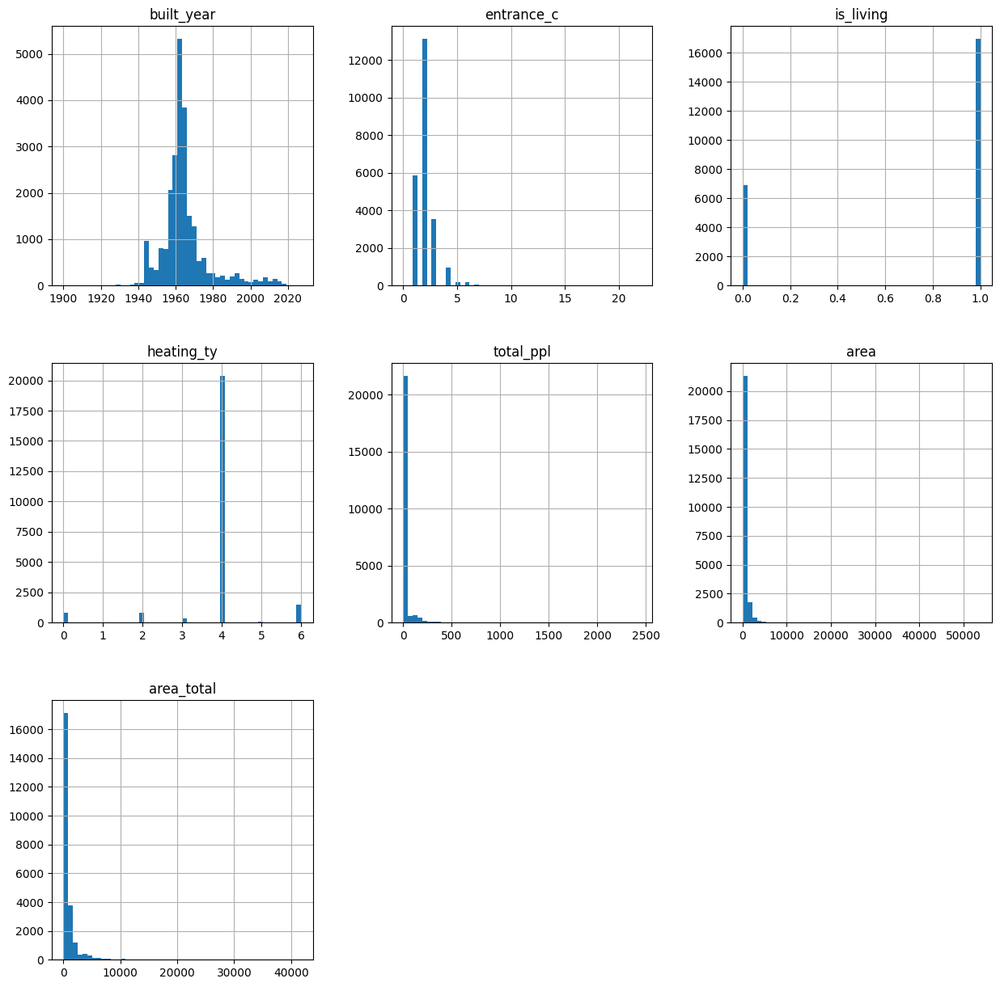

In [25]:
import matplotlib.pyplot as plt
full_data.drop(['geometry'], axis=1).hist(bins=50,figsize=(15,15))
plt.show()

<h1>Отображаем город и здания на карте</h1>

In [8]:
TERITORY_NAME = 'Калининград'

territory = ox.geocode_to_gdf(TERITORY_NAME)
territory.explore(tiles="CartoDB positron")

In [26]:
full_data.explore(tiles="CartoDB positron")